## Import Library and Dataset

In [2]:
import pandas as pd
import numpy as np
###visualization###
import matplotlib.pyplot as plt 
from PIL import  Image
import seaborn as sns 
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff

In [3]:
Airline = pd.read_csv (r"C:\Users\Sai\Desktop\python\Machine Learning\practice\airline_passenger_satisfaction.csv")
Airline.head()

,Unnamed: 0,Gender,customer_type,age,type_of_travel,customer_class,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,...,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes,satisfaction
0,0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


## Data Pre-Processing

In [4]:
Airline.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         129880 non-null  int64  
 1   Gender                             129880 non-null  object 
 2   customer_type                      129880 non-null  object 
 3   age                                129880 non-null  int64  
 4   type_of_travel                     129880 non-null  object 
 5   customer_class                     129880 non-null  object 
 6   flight_distance                    129880 non-null  int64  
 7   inflight_wifi_service              129880 non-null  int64  
 8   departure_arrival_time_convenient  129880 non-null  int64  
 9   ease_of_online_booking             129880 non-null  int64  
 10  gate_location                      129880 non-null  int64  
 11  food_and_drink                     1298

In [5]:
Airline.describe()

,Unnamed: 0,age,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,food_and_drink,online_boarding,seat_comfort,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes
count,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129487.000000
mean,64939.500000,39.427957,1190.316392,2.728696,3.057599,2.756876,2.976925,3.204774,3.252633,3.441361,3.358077,3.383023,3.350878,3.632114,3.306267,3.642193,3.286326,14.713713,15.091129
std,37493.270818,15.119360,997.452477,1.329340,1.526741,1.401740,1.278520,1.329933,1.350719,1.319289,1.334049,1.287099,1.316252,1.180025,1.266185,1.176669,1.313682,38.071126,38.465650
min,0.000000,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,32469.750000,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,64939.500000,40.000000,844.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000
75%,97409.250000,51.000000,1744.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,129879.000000,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000


## Removing Irrelavent Variable

In [6]:
Airline = Airline.drop(['Unnamed: 0'], axis=1)
Airline

,Gender,customer_type,age,type_of_travel,customer_class,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,...,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes,satisfaction
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129875,Male,disloyal Customer,34,Business travel,Business,526,3,3,3,1,...,4,3,2,4,4,5,4,0,0.0,neutral or dissatisfied
129876,Male,Loyal Customer,23,Business travel,Business,646,4,4,4,4,...,4,4,5,5,5,5,4,0,0.0,satisfied
129877,Female,Loyal Customer,17,Personal Travel,Eco,828,2,5,1,5,...,2,4,3,4,5,4,2,0,0.0,neutral or dissatisfied
129878,Male,Loyal Customer,14,Business travel,Business,1127,3,3,3,3,...,4,3,2,5,4,5,4,0,0.0,satisfied


##### Check for missing value

In [7]:
Airline.isnull().sum()

Gender                                 0
customer_type                          0
age                                    0
type_of_travel                         0
customer_class                         0
flight_distance                        0
inflight_wifi_service                  0
departure_arrival_time_convenient      0
ease_of_online_booking                 0
gate_location                          0
food_and_drink                         0
online_boarding                        0
seat_comfort                           0
inflight_entertainment                 0
onboard_service                        0
leg_room_service                       0
baggage_handling                       0
checkin_service                        0
inflight_service                       0
cleanliness                            0
departure_delay_in_minutes             0
arrival_delay_in_minutes             393
satisfaction                           0
dtype: int64

* Missing values found 
* Treat for missing value:replace by mean

In [8]:
Airline['arrival_delay_in_minutes'].fillna(Airline['arrival_delay_in_minutes'].mean(),inplace=True)

##### Again check for missing values

In [9]:
Airline.isnull().sum()

Gender                               0
customer_type                        0
age                                  0
type_of_travel                       0
customer_class                       0
flight_distance                      0
inflight_wifi_service                0
departure_arrival_time_convenient    0
ease_of_online_booking               0
gate_location                        0
food_and_drink                       0
online_boarding                      0
seat_comfort                         0
inflight_entertainment               0
onboard_service                      0
leg_room_service                     0
baggage_handling                     0
checkin_service                      0
inflight_service                     0
cleanliness                          0
departure_delay_in_minutes           0
arrival_delay_in_minutes             0
satisfaction                         0
dtype: int64

Now,No missing values found

##### Check for outliers

<AxesSubplot:>

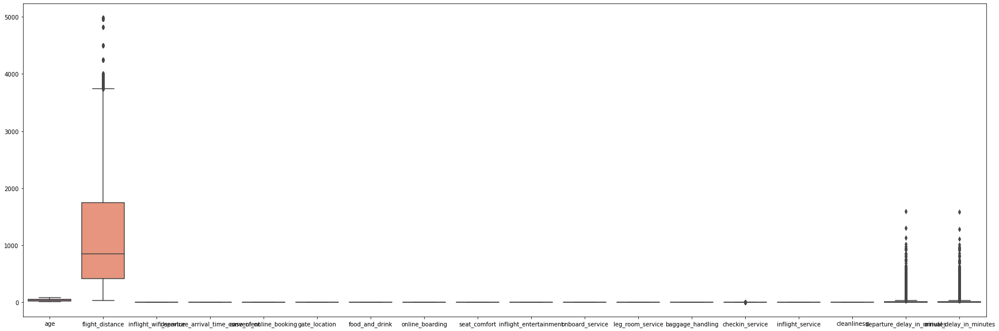

In [10]:
plt.figure(figsize=(30,10))
sns.boxplot(data=Airline)

Outliers found

##### Now we treat Outliers:Using Winsorizing Technique

In [11]:
i=Airline.select_dtypes(include=[np.number]).columns
i

Index(['age', 'flight_distance', 'inflight_wifi_service',
       'departure_arrival_time_convenient', 'ease_of_online_booking',
       'gate_location', 'food_and_drink', 'online_boarding', 'seat_comfort',
       'inflight_entertainment', 'onboard_service', 'leg_room_service',
       'baggage_handling', 'checkin_service', 'inflight_service',
       'cleanliness', 'departure_delay_in_minutes',
       'arrival_delay_in_minutes'],
      dtype='object')

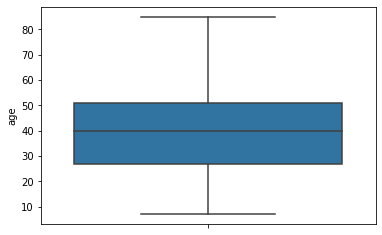

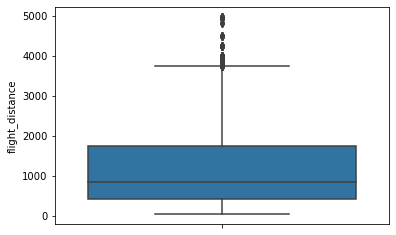

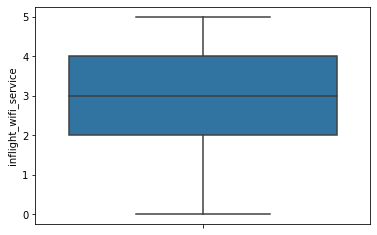

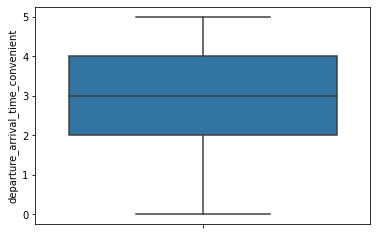

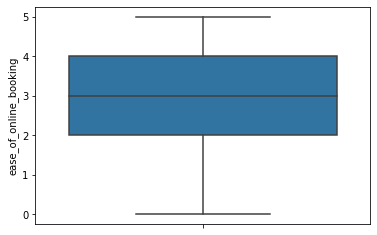

...

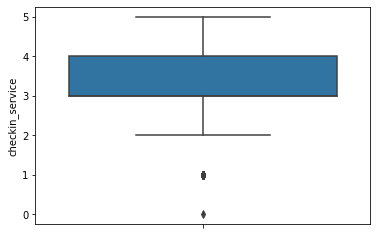

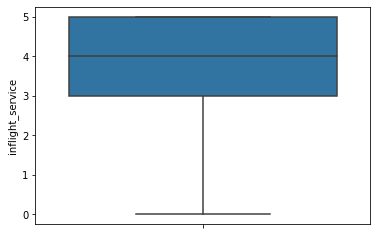

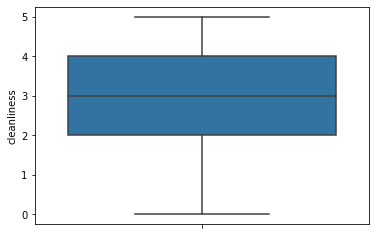

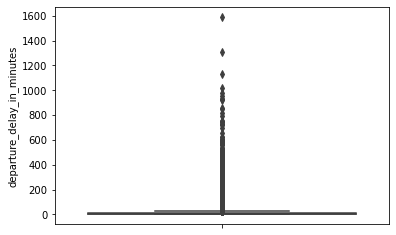

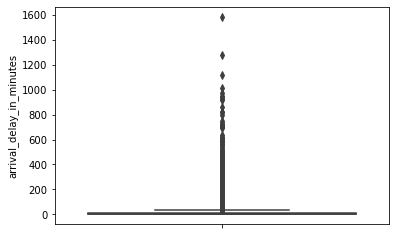

In [12]:
import matplotlib.pyplot as plt
i=Airline.select_dtypes(include=[np.number]).columns

for j in i:
    plt.figure()
    sns.boxplot(y=Airline[j])

In [13]:
def outliers(df,colname):
    q1 = df[colname].quantile(0.25)
    q3 = df[colname].quantile(0.75)
    iqr = q3-q1 #Interquartile range
    low_limit = q1-1.5*iqr #acceptable range
    upper_limit = q3+1.5*iqr #acceptable range
    df[colname]=(np.where(df[colname] > upper_limit,upper_limit,df[colname])) 
    df[colname]=np.where(df[colname] < low_limit,low_limit,df[colname])
    return df[colname]

In [14]:
for j in i:
    print(outliers(Airline,j))

0         13.0
1         25.0
2         26.0
3         25.0
4         61.0
          ... 
129875    34.0
129876    23.0
129877    17.0
129878    14.0
129879    42.0
Name: age, Length: 129880, dtype: float64
0          460.0
1          235.0
2         1142.0
3          562.0
4          214.0
           ...  
129875     526.0
129876     646.0
129877     828.0
129878    1127.0
129879     264.0
Name: flight_distance, Length: 129880, dtype: float64
0         3.0
1         3.0
2         2.0
3         2.0
4         3.0
         ... 
129875    3.0
129876    4.0
129877    2.0
129878    3.0
129879    2.0
Name: inflight_wifi_service, Length: 129880, dtype: float64
0         4.0
1         2.0
2         2.0
3         5.0
4         3.0
         ... 
129875    3.0
129876    4.0
129877    5.0
129878    3.0
129879    5.0
Name: departure_arrival_time_convenient, Length: 129880, dtype: float64
0         3.0
1         3.0
2         2.0
3         5.0
4         3.0
         ... 
129875    3.0
129876    4.0


In [15]:
for j in i:
    print(outliers(Airline,j))

0         13.0
1         25.0
2         26.0
3         25.0
4         61.0
          ... 
129875    34.0
129876    23.0
129877    17.0
129878    14.0
129879    42.0
Name: age, Length: 129880, dtype: float64
0          460.0
1          235.0
2         1142.0
3          562.0
4          214.0
           ...  
129875     526.0
129876     646.0
129877     828.0
129878    1127.0
129879     264.0
Name: flight_distance, Length: 129880, dtype: float64
0         3.0
1         3.0
2         2.0
3         2.0
4         3.0
         ... 
129875    3.0
129876    4.0
129877    2.0
129878    3.0
129879    2.0
Name: inflight_wifi_service, Length: 129880, dtype: float64
0         4.0
1         2.0
2         2.0
3         5.0
4         3.0
         ... 
129875    3.0
129876    4.0
129877    5.0
129878    3.0
129879    5.0
Name: departure_arrival_time_convenient, Length: 129880, dtype: float64
0         3.0
1         3.0
2         2.0
3         5.0
4         3.0
         ... 
129875    3.0
129876    4.0


##### Again check for outliers

<AxesSubplot:>

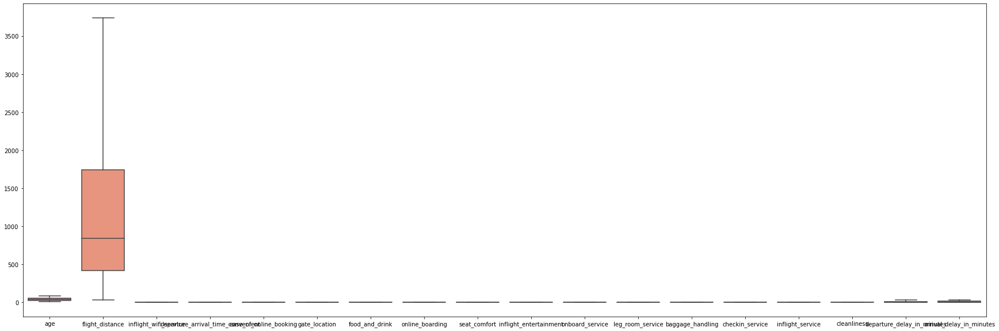

In [16]:
plt.figure(figsize=(30,10))
sns.boxplot(data=Airline)

## EDA
Flight Satisfaction

* neutral or dissatisfied =0

* satisfied =1

In [17]:
Airline.satisfaction.value_counts()

neutral or dissatisfied    73452
satisfied                  56428
Name: satisfaction, dtype: int64

#### Trend Analysis

In [18]:
import plotly.express as px

fig = px.pie(Airline,names='satisfaction',color='satisfaction',
             color_discrete_map={'neutral or dissatisfied':'red',
                                 'satisfied':'green'})
fig.show()

* rate of not satisfied peoples is 56.6%
* and rate of satisfied peoples are 43.4%

### Reject Airline data = Bad Airline service

In [19]:
Airline_Good= Airline[Airline["satisfaction"] == "satisfied"] 

Airline_Good

,Gender,customer_type,age,type_of_travel,customer_class,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,...,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes,satisfaction
2,Female,Loyal Customer,26.0,Business travel,Business,1142.0,2.0,2.0,2.0,2.0,...,5.0,4.0,3.0,4.0,4.0,4.0,5.0,0.0,0.0,satisfied
4,Male,Loyal Customer,61.0,Business travel,Business,214.0,3.0,3.0,3.0,3.0,...,3.0,3.0,4.0,4.0,3.0,3.0,3.0,0.0,0.0,satisfied
7,Female,Loyal Customer,52.0,Business travel,Business,2035.0,4.0,3.0,4.0,4.0,...,5.0,5.0,5.0,5.0,4.0,5.0,4.0,4.0,0.0,satisfied
13,Male,Loyal Customer,33.0,Personal Travel,Eco,946.0,4.0,2.0,4.0,3.0,...,4.0,4.0,5.0,2.0,2.0,2.0,4.0,0.0,0.0,satisfied
16,Female,Loyal Customer,26.0,Business travel,Business,2123.0,3.0,3.0,3.0,3.0,...,4.0,5.0,3.0,4.0,5.0,4.0,4.0,30.0,32.5,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129860,Female,Loyal Customer,29.0,Business travel,Business,2864.0,5.0,5.0,5.0,5.0,...,3.0,5.0,5.0,5.0,3.0,5.0,3.0,0.0,0.0,satisfied
129865,Male,Loyal Customer,51.0,Business travel,Business,2296.0,3.0,3.0,3.0,3.0,...,5.0,5.0,5.0,5.0,3.0,5.0,3.0,2.0,0.0,satisfied
129873,Male,Loyal Customer,52.0,Business travel,Business,280.0,3.0,3.0,3.0,3.0,...,4.0,4.0,4.0,4.0,3.0,4.0,3.0,0.0,0.0,satisfied
129876,Male,Loyal Customer,23.0,Business travel,Business,646.0,4.0,4.0,4.0,4.0,...,4.0,4.0,5.0,5.0,5.0,5.0,4.0,0.0,0.0,satisfied


In [20]:
fig = px.sunburst(Airline_Good, path=["Gender",'customer_type','type_of_travel',
                                    'customer_class'])
fig.show()

### Breaking Data into Two Part
* Quantitative Variable
* Qualitative Variable

In [21]:
Quantitative_Variable = Airline[Airline.select_dtypes(include=[np.number]).columns.tolist()]
Quantitative_Variable.head(3)

,age,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,food_and_drink,online_boarding,seat_comfort,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes
0,13.0,460.0,3.0,4.0,3.0,1.0,5.0,3.0,5.0,5.0,4.0,3.0,4.0,4.0,5.0,5.0,25.0,18.0
1,25.0,235.0,3.0,2.0,3.0,3.0,1.0,3.0,1.0,1.0,1.0,5.0,3.0,1.5,4.0,1.0,1.0,6.0
2,26.0,1142.0,2.0,2.0,2.0,2.0,5.0,5.0,5.0,5.0,4.0,3.0,4.0,4.0,4.0,5.0,0.0,0.0


In [22]:
Qualitative_Variable = Airline[Airline.select_dtypes(include=['object']).columns.tolist()]
Qualitative_Variable.head(3)

,Gender,customer_type,type_of_travel,customer_class,satisfaction
0,Male,Loyal Customer,Personal Travel,Eco Plus,neutral or dissatisfied
1,Male,disloyal Customer,Business travel,Business,neutral or dissatisfied
2,Female,Loyal Customer,Business travel,Business,satisfied


### Converting qualitative Variable into number

In [23]:
from sklearn.preprocessing import LabelEncoder
Qualitative_Variable=Qualitative_Variable.apply(LabelEncoder().fit_transform) # label in ascending order
Qualitative_Variable.head()

,Gender,customer_type,type_of_travel,customer_class,satisfaction
0,1,0,1,2,0
1,1,1,0,0,0
2,0,0,0,0,1
3,0,0,0,0,0
4,1,0,0,0,1


#### Combining the data set

In [24]:
Airline_final = pd.concat([Qualitative_Variable, Quantitative_Variable],axis=1)
Airline_final.head()

,Gender,customer_type,type_of_travel,customer_class,satisfaction,age,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,...,seat_comfort,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes
0,1,0,1,2,0,13.0,460.0,3.0,4.0,3.0,...,5.0,5.0,4.0,3.0,4.0,4.0,5.0,5.0,25.0,18.0
1,1,1,0,0,0,25.0,235.0,3.0,2.0,3.0,...,1.0,1.0,1.0,5.0,3.0,1.5,4.0,1.0,1.0,6.0
2,0,0,0,0,1,26.0,1142.0,2.0,2.0,2.0,...,5.0,5.0,4.0,3.0,4.0,4.0,4.0,5.0,0.0,0.0
3,0,0,0,0,0,25.0,562.0,2.0,5.0,5.0,...,2.0,2.0,2.0,5.0,3.0,1.5,4.0,2.0,11.0,9.0
4,1,0,0,0,1,61.0,214.0,3.0,3.0,3.0,...,5.0,3.0,3.0,4.0,4.0,3.0,3.0,3.0,0.0,0.0


## Data Partition

In [25]:
Airline.head()

,Gender,customer_type,age,type_of_travel,customer_class,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,...,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes,satisfaction
0,Male,Loyal Customer,13.0,Personal Travel,Eco Plus,460.0,3.0,4.0,3.0,1.0,...,5.0,4.0,3.0,4.0,4.0,5.0,5.0,25.0,18.0,neutral or dissatisfied
1,Male,disloyal Customer,25.0,Business travel,Business,235.0,3.0,2.0,3.0,3.0,...,1.0,1.0,5.0,3.0,1.5,4.0,1.0,1.0,6.0,neutral or dissatisfied
2,Female,Loyal Customer,26.0,Business travel,Business,1142.0,2.0,2.0,2.0,2.0,...,5.0,4.0,3.0,4.0,4.0,4.0,5.0,0.0,0.0,satisfied
3,Female,Loyal Customer,25.0,Business travel,Business,562.0,2.0,5.0,5.0,5.0,...,2.0,2.0,5.0,3.0,1.5,4.0,2.0,11.0,9.0,neutral or dissatisfied
4,Male,Loyal Customer,61.0,Business travel,Business,214.0,3.0,3.0,3.0,3.0,...,3.0,3.0,4.0,4.0,3.0,3.0,3.0,0.0,0.0,satisfied


In [26]:
from sklearn.model_selection import train_test_split
X = Airline_final.drop('satisfaction', axis = 1)
Y = Airline_final[['satisfaction']]
# Split X and y into X_
X_train, X_test, y_train, y_test= train_test_split(X, Y, test_size=0.20, random_state=43)

## Model Building

In [27]:
from sklearn import tree

dt = tree.DecisionTreeClassifier()  # by default it use Gini index for split
#Train the model using the training sets
dt.fit(X_train,y_train) #model name=dt

DecisionTreeClassifier()

### Plotting the Tree

In [28]:
train=pd.concat([X_train,y_train],axis=1)
train.head()

,Gender,customer_type,type_of_travel,customer_class,age,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,...,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes,satisfaction
75983,0,0,1,1,55.0,2367.0,2.0,5.0,1.0,4.0,...,5.0,5.0,1.0,5.0,3.0,5.0,4.0,0.0,0.0,0
45453,1,1,0,1,44.0,209.0,2.0,4.0,2.0,2.0,...,5.0,1.0,5.0,3.0,3.0,2.0,5.0,8.0,30.0,0
86275,0,0,0,0,42.0,515.0,2.0,2.0,2.0,2.0,...,5.0,5.0,5.0,5.0,5.0,5.0,5.0,16.0,13.0,1
114690,0,0,0,0,34.0,1609.0,5.0,5.0,5.0,5.0,...,5.0,5.0,5.0,5.0,4.0,5.0,4.0,0.0,2.0,1
22859,1,1,0,0,59.0,184.0,4.0,4.0,4.0,3.0,...,1.0,4.0,5.0,4.0,5.0,4.0,1.0,0.0,0.0,1


In [29]:
features = list(train.columns[1:])
features

['customer_type',
 'type_of_travel',
 'customer_class',
 'age',
 'flight_distance',
 'inflight_wifi_service',
 'departure_arrival_time_convenient',
 'ease_of_online_booking',
 'gate_location',
 'food_and_drink',
 'online_boarding',
 'seat_comfort',
 'inflight_entertainment',
 'onboard_service',
 'leg_room_service',
 'baggage_handling',
 'checkin_service',
 'inflight_service',
 'cleanliness',
 'departure_delay_in_minutes',
 'arrival_delay_in_minutes',
 'satisfaction']

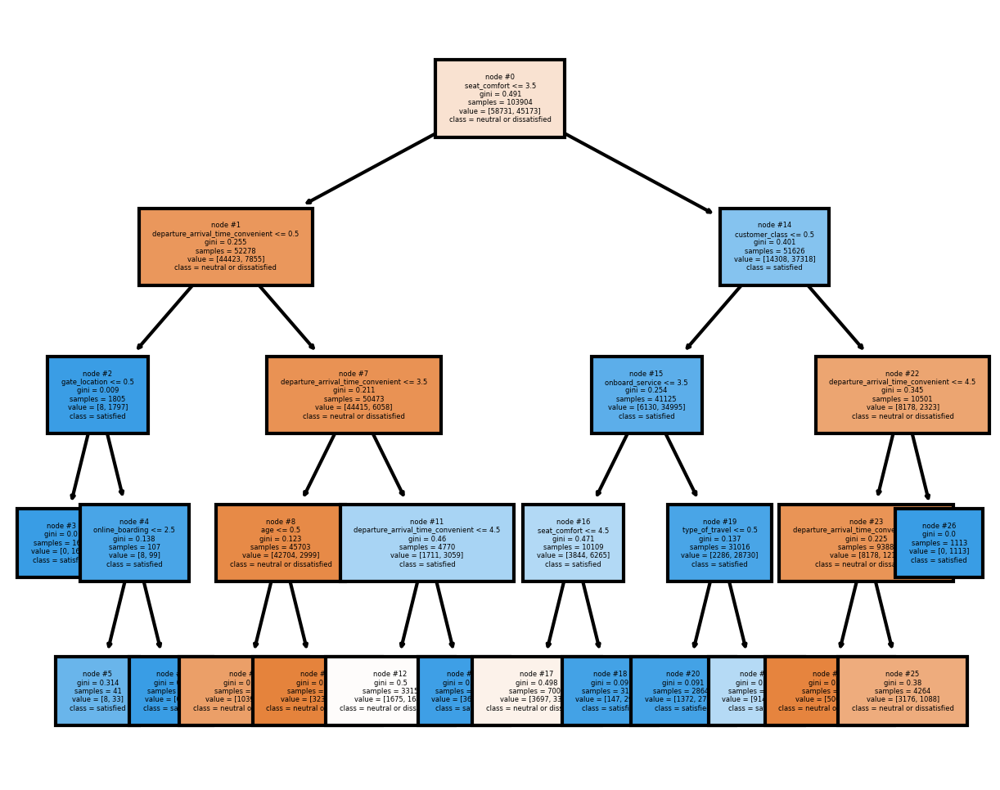

In [53]:
from sklearn import tree
import matplotlib.pyplot as plt

satisfaction=['neutral or dissatisfied', 'satisfied']  # array
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (5,4), dpi=300)
tree.plot_tree(dt,
               feature_names = features, #column name
               class_names=satisfaction,  #yes,no
               filled = True, # colour
              node_ids=True, # node number
              fontsize=2); # 


### Predictions on Train Dataset

In [36]:
train.head()

,Gender,customer_type,type_of_travel,customer_class,age,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,...,inflight_entertainment,onboard_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes,satisfaction
75983,0,0,1,1,55.0,2367.0,2.0,5.0,1.0,4.0,...,5.0,5.0,1.0,5.0,3.0,5.0,4.0,0.0,0.0,0
45453,1,1,0,1,44.0,209.0,2.0,4.0,2.0,2.0,...,5.0,1.0,5.0,3.0,3.0,2.0,5.0,8.0,30.0,0
86275,0,0,0,0,42.0,515.0,2.0,2.0,2.0,2.0,...,5.0,5.0,5.0,5.0,5.0,5.0,5.0,16.0,13.0,1
114690,0,0,0,0,34.0,1609.0,5.0,5.0,5.0,5.0,...,5.0,5.0,5.0,5.0,4.0,5.0,4.0,0.0,2.0,1
22859,1,1,0,0,59.0,184.0,4.0,4.0,4.0,3.0,...,1.0,4.0,5.0,4.0,5.0,4.0,1.0,0.0,0.0,1


In [ ]:
train['Predicted']=dt.predict(X_train)  #model=dt
train.head()

## Model Performance Metrics

In [ ]:
from sklearn.metrics import confusion_matrix  
matrix = confusion_matrix(train['Predicted'],train['satisfaction'])
print(matrix)

### Final accuracy of Model Before Pruning

In [ ]:
Accuracy_Train=((56254+36012)/(103904)*100)
print(Accuracy_Train)   # overfit or high accuracy

### Predictions on Test Dataset

In [ ]:
test=pd.concat([X_test,y_test],axis=1)
test.head()

In [ ]:
test['Predicted']=dt.predict(X_test)
test.head()

### Model Performance Metrics on Test data

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(test['Predicted'],test['satisfaction'])
print(confusion_matrix)

In [ ]:
Accuracy_test=((14138+8992)/(25976)*100)
Accuracy_test

## Sensitivity & Specificity( Pruning)

#### Train

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(train['satisfaction'], train['Predicted']))

### After Pruning

* Accuracy of Model is 89% , So we say Model good fit data
* Accuracy of Bad Airline Review Capture by Model is 96% ( Sensitivity )
* Accuracy of Good Airline Review Capture by Model is 80%(Specificity)

##### Test

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(test['satisfaction'], test['Predicted']))

### After Pruning
* Accuracy of Model is 89% , So we say Model good fit data
* Accuracy of Bad Airline Review Capture by Model is 96% ( Sensitivity )
* Accuracy of Good Airline Review Capture by Model is 80%(Specificity)

### Pruning method

## Grid Search Method

In [50]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
params = { 'min_samples_split': [70, 80,90], ## Parent 
           'min_samples_leaf': [40,50,60], ## Child or Leave 
           'max_depth':[3,4,4]}
grid_search_cv = GridSearchCV(DecisionTreeClassifier(random_state=42), params, verbose=1, cv=10)
grid_search_cv.fit(X_train, y_train)

Fitting 10 folds for each of 27 candidates, totalling 270 fits


GridSearchCV(cv=10, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_depth': [3, 4, 4],
                         'min_samples_leaf': [40, 50, 60],
                         'min_samples_split': [70, 80, 90]},
             verbose=1)

In [51]:
grid_search_cv.best_estimator_

DecisionTreeClassifier(max_depth=4, min_samples_leaf=40, min_samples_split=70,
                       random_state=42)

### Model Improvement by Pruning Method ( Cut Tree)

In [52]:
#### Import Tree Classifier model
from sklearn import tree

dt = tree.DecisionTreeClassifier(criterion='gini',  #splitter
                                 min_samples_leaf=40,## child
                                 min_samples_split=70, #parent 
                                 max_depth=4)  #branches
#Train the model using the training sets
dt.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=4, min_samples_leaf=40, min_samples_split=70)

### After Running this go back then run from Plotting the Graph